In [1]:
import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt
from IPython.display import HTML

In [2]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, Activation, Flatten, BatchNormalization, Conv2D, MaxPool2D,Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from tensorflow.keras.applications import imagenet_utils
from sklearn.metrics import confusion_matrix
from tensorflow.keras.optimizers import Adam
import itertools
import os
import shutil
import random
import matplotlib.pyplot as plt
%matplotlib inline
from tensorflow.keras.models import Sequential

import cv2

ModuleNotFoundError: No module named 'cv2'

In [3]:
!pip install split-folders

In [4]:
import splitfolders

In [5]:
import splitfolders


input_folder = r"C:\Users\Sameera maduSanka\Downloads\sam MobileNet\copy" 
output_folder = r"C:\Users\Sameera maduSanka\Downloads\sam MobileNet\dataSet"


splitfolders.ratio(input_folder, output=output_folder, seed=42, ratio=(0.8, 0.1, 0.1))

Copying files: 791 files [00:10, 77.67 files/s]


In [6]:
train_ds = 'dataSet/train'
valid_ds = 'dataSet/val'
test_ds = 'dataSet/test'

# data preprocces

In [7]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=train_ds, target_size=(224,224), batch_size=10)
valid_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=valid_ds, target_size=(224,224), batch_size=10)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=test_ds, target_size=(224,224), batch_size=10, shuffle=False)

Found 630 images belonging to 5 classes.
Found 76 images belonging to 5 classes.
Found 85 images belonging to 5 classes.


In [8]:
import tensorflow as tf

mobile_net_v2 = tf.keras.applications.MobileNetV2()

14536120/14536120 [==============================] - 4s 0us/step


In [9]:
mobile_net_v2.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

# Remove last 2 layesr in the mobile_net_v2

In [10]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
mobile_net_v2 = MobileNetV2(weights='imagenet', include_top=True)


new_model = tf.keras.Model(inputs=mobile_net_v2.input, outputs=mobile_net_v2.layers[-2].output)


new_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_2[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']        

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

# Add my customized last layer

In [11]:
num_classes = 5
new_last_layer = tf.keras.layers.Dense(num_classes, activation='softmax')(new_model.output)

# Create the final model with the new last layer
final_model = tf.keras.Model(inputs=new_model.input, outputs=new_last_layer)

# Print the summary of the final model
final_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_2[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']      

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

In [12]:
final_model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [13]:
history=final_model.fit(x=train_batches,
            steps_per_epoch=len(train_batches),
            validation_data=valid_batches,
            validation_steps=len(valid_batches),
            epochs=10,
            verbose=2
)

Epoch 1/10
63/63 - 116s - loss: 0.4846 - accuracy: 0.8492 - val_loss: 0.2386 - val_accuracy: 0.9079 - 116s/epoch - 2s/step
Epoch 2/10
63/63 - 102s - loss: 0.0601 - accuracy: 0.9921 - val_loss: 0.1401 - val_accuracy: 0.9474 - 102s/epoch - 2s/step
Epoch 3/10
63/63 - 96s - loss: 0.0315 - accuracy: 0.9952 - val_loss: 0.0864 - val_accuracy: 0.9605 - 96s/epoch - 2s/step
Epoch 4/10
63/63 - 99s - loss: 0.0182 - accuracy: 0.9968 - val_loss: 0.0802 - val_accuracy: 0.9737 - 99s/epoch - 2s/step
Epoch 5/10
63/63 - 95s - loss: 0.0211 - accuracy: 0.9968 - val_loss: 0.0764 - val_accuracy: 0.9737 - 95s/epoch - 2s/step
Epoch 6/10
63/63 - 95s - loss: 0.0239 - accuracy: 0.9952 - val_loss: 0.1896 - val_accuracy: 0.9474 - 95s/epoch - 2s/step
Epoch 7/10
63/63 - 100s - loss: 0.0165 - accuracy: 0.9952 - val_loss: 0.1316 - val_accuracy: 0.9474 - 100s/epoch - 2s/step
Epoch 8/10
63/63 - 96s - loss: 0.0122 - accuracy: 0.9968 - val_loss: 0.2524 - val_accuracy: 0.9474 - 96s/epoch - 2s/step
Epoch 9/10
63/63 - 96s - l

In [14]:
import os.path
final_model.save('V1.0.h5')

D:\Appz\anaconda\lib\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [17]:
converter = tf.lite.TFLiteConverter.from_keras_model(final_model)
tflite_model = converter.convert()

# Define the complete path and filename for saving the model
tflite_model_path = "C:/Users/Sameera maduSanka/Downloads/sam MobileNet/TenserflowLite/final_model.tflite"

# Save the TensorFlow Lite model to the specified location
with open(tflite_model_path, 'wb') as f:
    f.write(tflite_model)

print(f"TensorFlow Lite model saved at: {tflite_model_path}")

INFO:tensorflow:Assets written to: C:\Users\SAMEER~1\AppData\Local\Temp\tmpu72kgu2n\assets


INFO:tensorflow:Assets written to: C:\Users\SAMEER~1\AppData\Local\Temp\tmpu72kgu2n\assets


TensorFlow Lite model saved at: C:/Users/Sameera maduSanka/Downloads/sam MobileNet/TenserflowLite/final_model.tflite


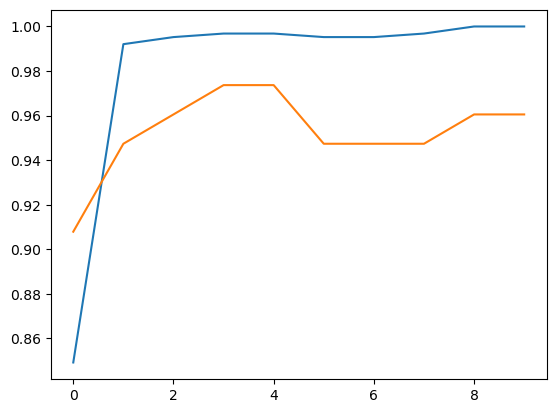

In [18]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

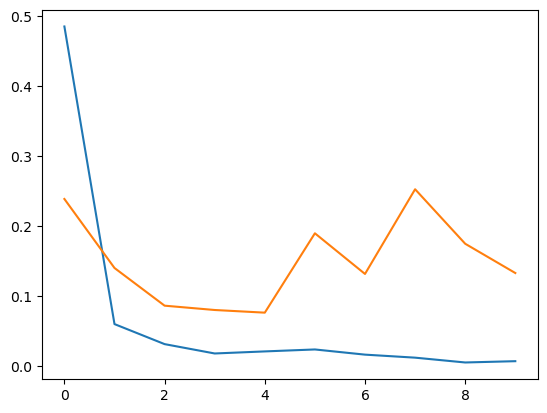

In [19]:
import matplotlib.pyplot as plt
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])

In [20]:
test_batches.class_indices

{'bulath hapaya': 0,
 'damkolapethiya': 1,
 'galpadiya': 2,
 'kawaiya': 3,
 'thalkossa (belontia signat )': 4}

In [21]:
test_labels = test_batches.classes

In [22]:
predictions = final_model.predict(x=test_batches, steps=len(test_batches), verbose=0)

In [23]:
predictions

array([[9.99957800e-01, 5.30300667e-07, 2.41860107e-05, 1.33153726e-05,
        4.16411922e-06],
       [9.99976635e-01, 8.72593432e-07, 3.31899673e-06, 1.72311557e-05,
        1.94894119e-06],
       [9.99998450e-01, 1.72791115e-08, 6.63697648e-08, 1.12800683e-06,
        2.83946605e-07],
       [9.99899387e-01, 9.61275964e-06, 3.85396270e-05, 4.77624562e-05,
        4.80667541e-06],
       [9.99985814e-01, 7.75539547e-07, 8.85659028e-06, 4.18439049e-06,
        3.04784464e-07],
       [9.99996662e-01, 1.46895857e-07, 5.79557195e-07, 2.57402075e-06,
        4.84112341e-08],
       [9.98874962e-01, 9.95846349e-04, 2.60169818e-05, 4.41829143e-05,
        5.90414602e-05],
       [9.99974728e-01, 3.23822007e-07, 1.49434427e-05, 9.51912443e-06,
        4.28301121e-07],
       [9.99990106e-01, 3.15627659e-07, 5.64832192e-07, 8.32219030e-06,
        6.78441438e-07],
       [9.99663591e-01, 3.21522930e-05, 1.47150946e-04, 1.54210808e-04,
        2.82828614e-06],
       [9.99933362e-01, 5.8190

In [24]:
pip install opencv-python

     ---------------------------------------- 38.1/38.1 MB 5.5 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [25]:
# Assuming you have preprocessed your test data into 'test_batches' (similar to how you preprocessed your train and validation data)
# 'test_batches' should be an instance of ImageDataGenerator.flow_from_directory()

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Iterate through the test batch and print image filename, predicted class name, and actual class name
for i in range(len(test_batches.filenames)):
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    
    print(f"Image: {image_filename} | Predicted: {predicted_class_name} | Actual: {actual_class_name}")


9/9 [==============================] - 8s 867ms/step
Image: bulath hapaya\2023_06_19_10_50_IMG_0713.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0714.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0716.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0746.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0750.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0773.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0776.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_51_IMG_0788.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_51_IMG_0826.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_

9/9 [==============================] - 6s 722ms/step


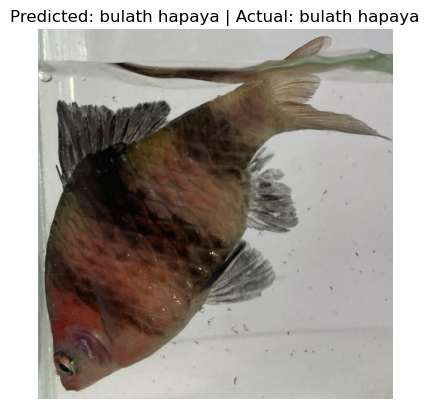

Image: bulath hapaya\2023_06_19_10_50_IMG_0713.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


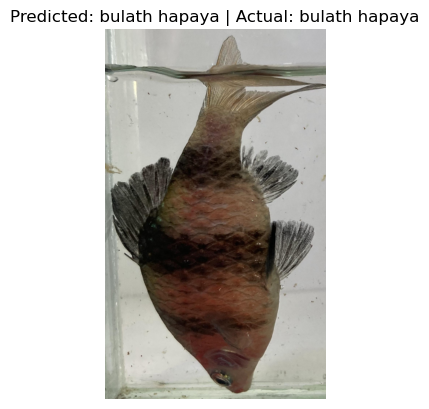

Image: bulath hapaya\2023_06_19_10_50_IMG_0714.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


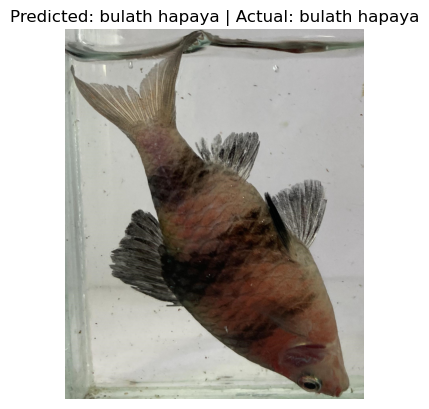

Image: bulath hapaya\2023_06_19_10_50_IMG_0716.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


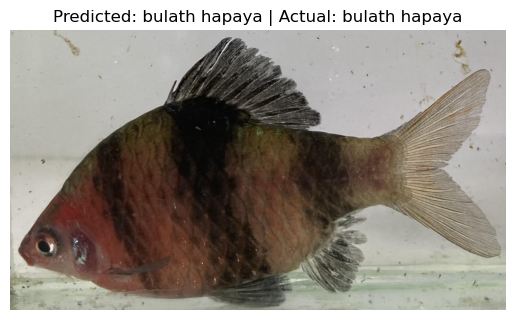

Image: bulath hapaya\2023_06_19_10_50_IMG_0746.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


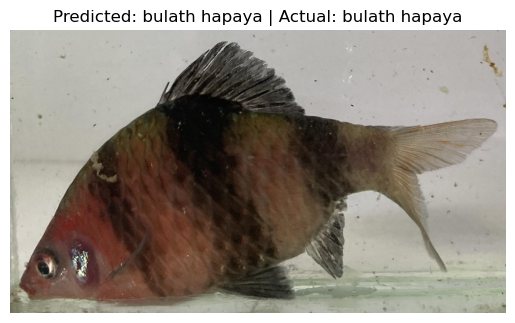

Image: bulath hapaya\2023_06_19_10_50_IMG_0750.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


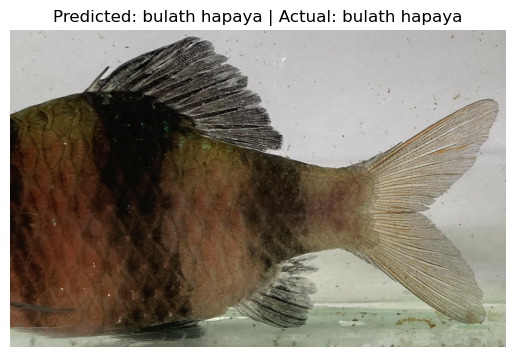

Image: bulath hapaya\2023_06_19_10_50_IMG_0773.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


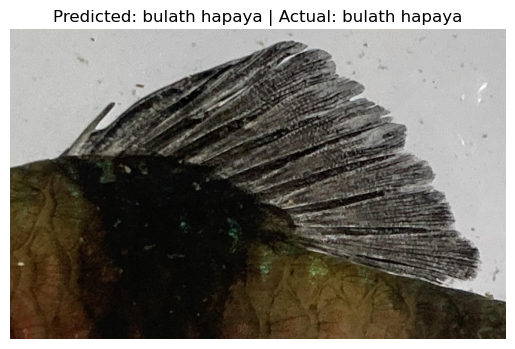

Image: bulath hapaya\2023_06_19_10_50_IMG_0776.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


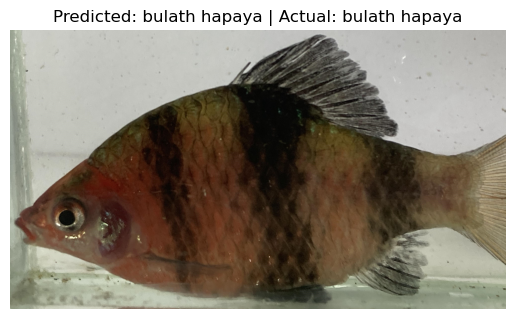

Image: bulath hapaya\2023_06_19_10_51_IMG_0788.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


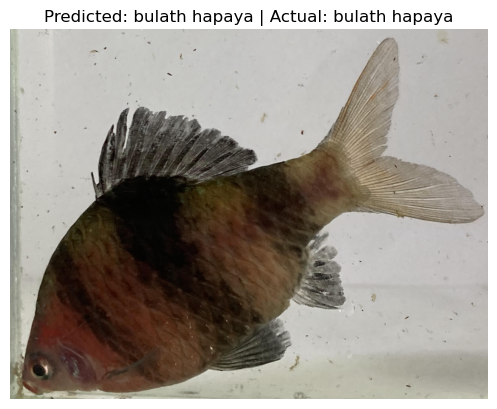

Image: bulath hapaya\2023_06_19_10_51_IMG_0826.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


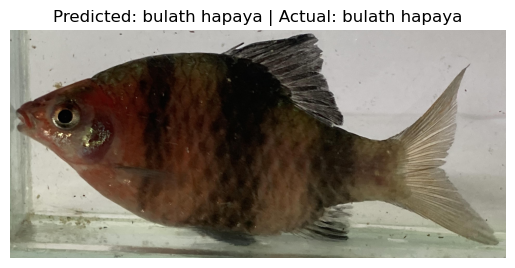

Image: bulath hapaya\2023_06_19_10_51_IMG_0828.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


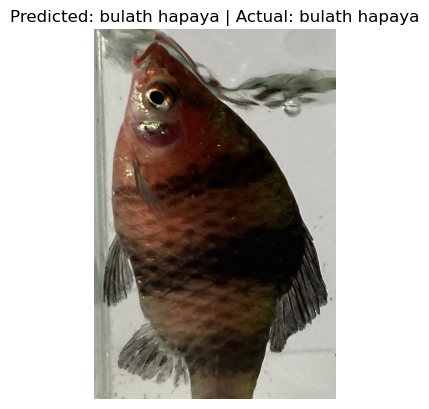

Image: bulath hapaya\2023_06_19_10_51_IMG_0830.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


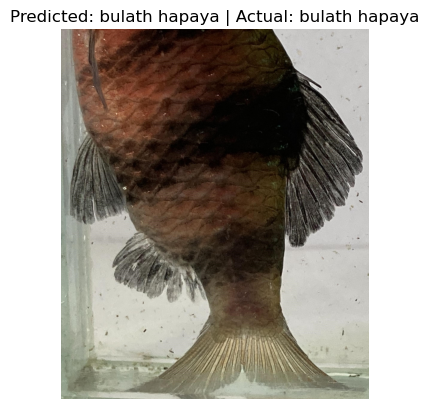

Image: bulath hapaya\2023_06_19_10_51_IMG_0833.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


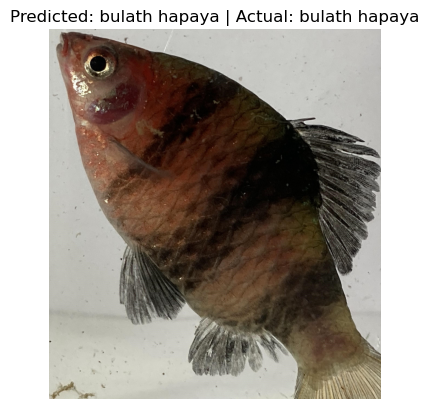

Image: bulath hapaya\2023_06_19_10_52_IMG_0845.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


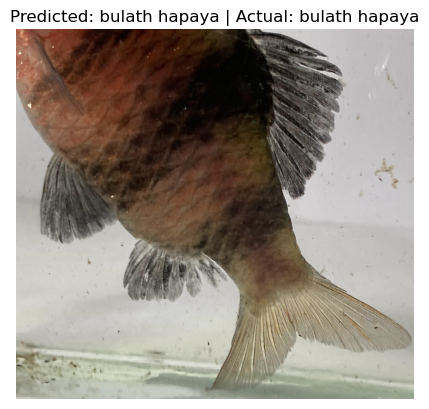

Image: bulath hapaya\2023_06_19_10_52_IMG_0885.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


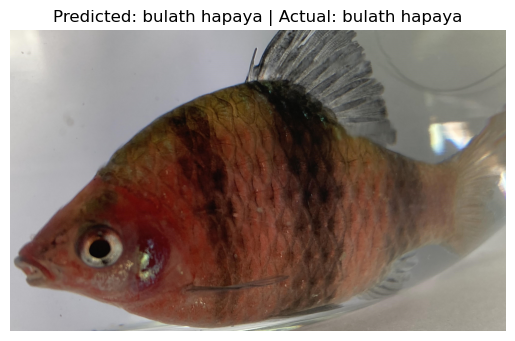

Image: bulath hapaya\2023_06_19_10_55_IMG_0917.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


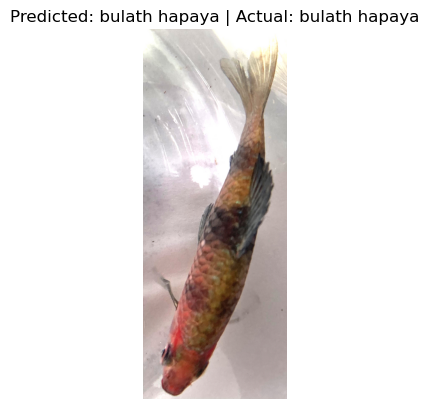

Image: bulath hapaya\2023_06_19_10_55_IMG_0933.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


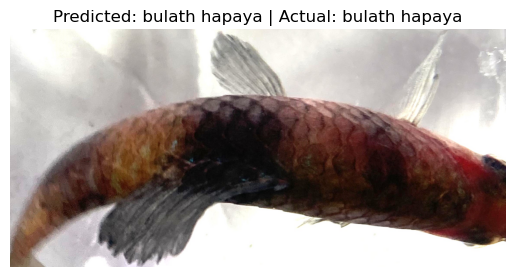

Image: bulath hapaya\2023_06_19_10_56_IMG_0946.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


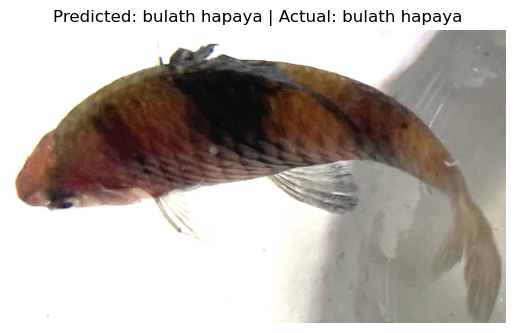

Image: bulath hapaya\2023_06_19_10_56_IMG_0952.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


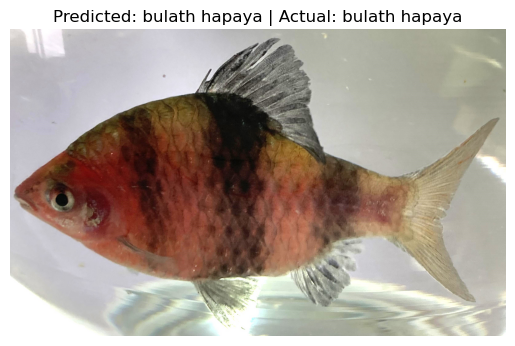

Image: bulath hapaya\2023_06_19_10_56_IMG_0964.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


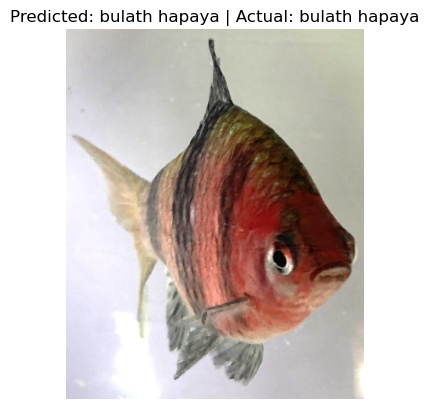

Image: bulath hapaya\2023_06_19_10_56_IMG_0977.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


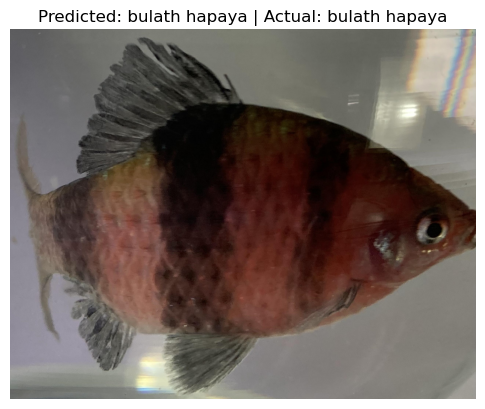

Image: bulath hapaya\2023_06_19_10_56_IMG_1003.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


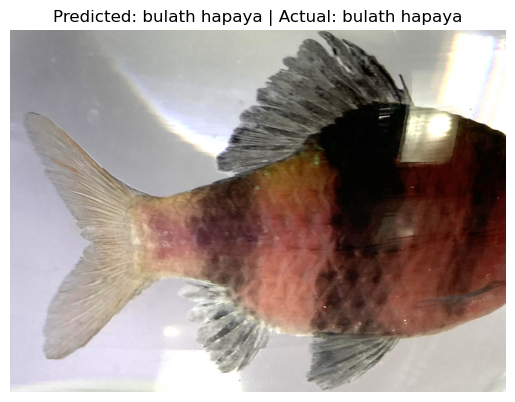

Image: bulath hapaya\2023_06_19_10_56_IMG_1004.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


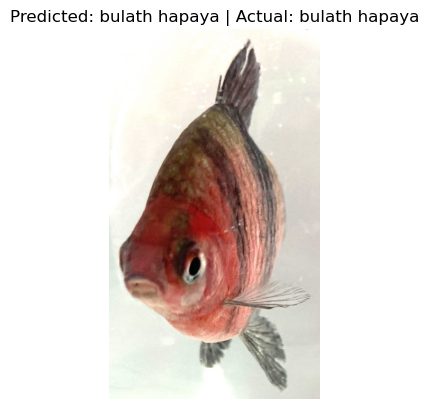

Image: bulath hapaya\2023_06_19_10_59_IMG_1112.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


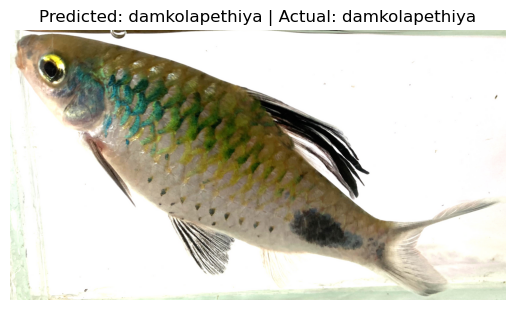

Image: damkolapethiya\2023_06_19_11_54_IMG_1768.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


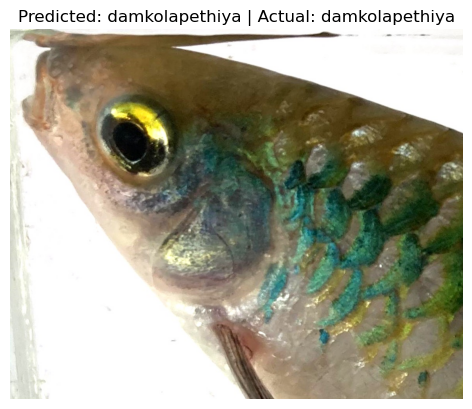

Image: damkolapethiya\2023_06_19_11_54_IMG_1769.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


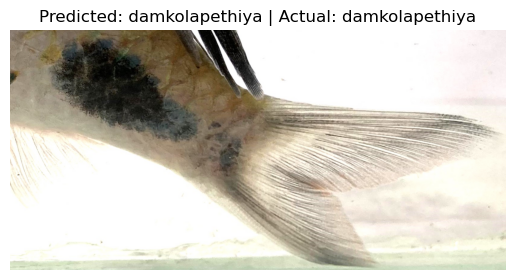

Image: damkolapethiya\2023_06_19_11_54_IMG_1771.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


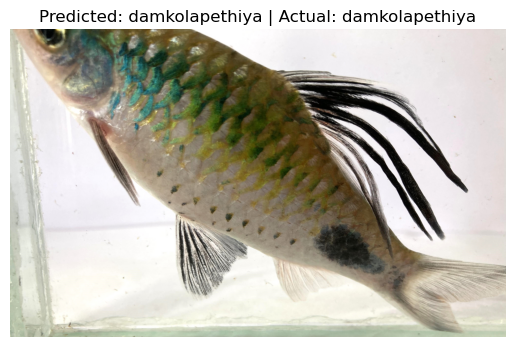

Image: damkolapethiya\2023_06_19_11_54_IMG_1788.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


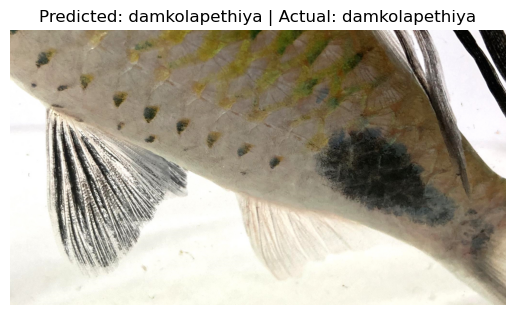

Image: damkolapethiya\2023_06_19_11_54_IMG_1789.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


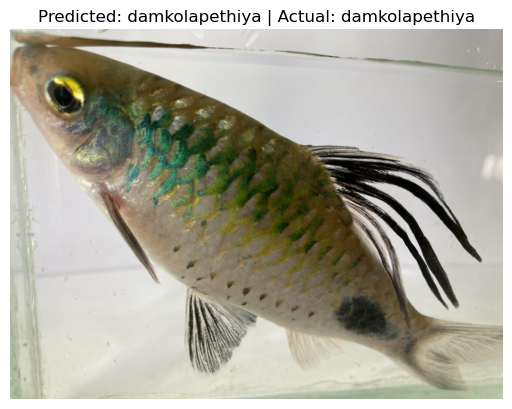

Image: damkolapethiya\2023_06_19_11_54_IMG_1797.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


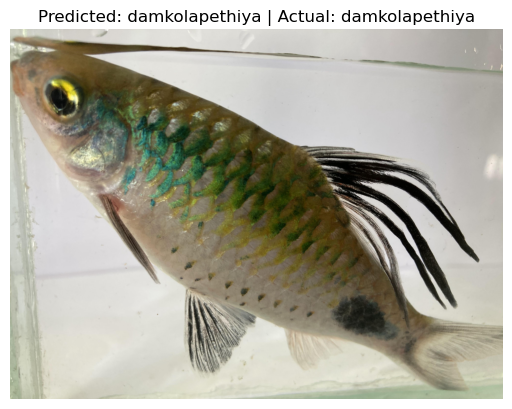

Image: damkolapethiya\2023_06_19_11_55_IMG_1804.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


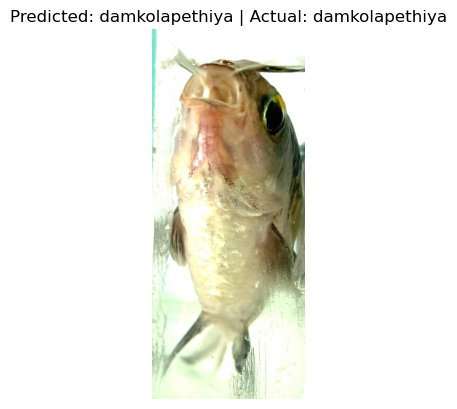

Image: damkolapethiya\2023_06_19_11_55_IMG_1819.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


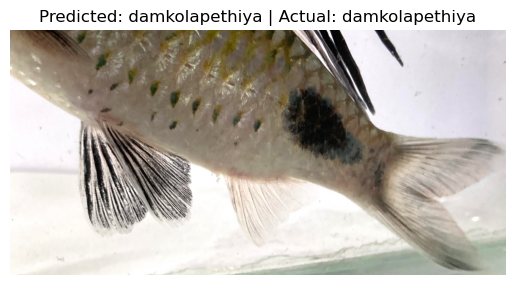

Image: damkolapethiya\2023_06_19_11_56_IMG_1861.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


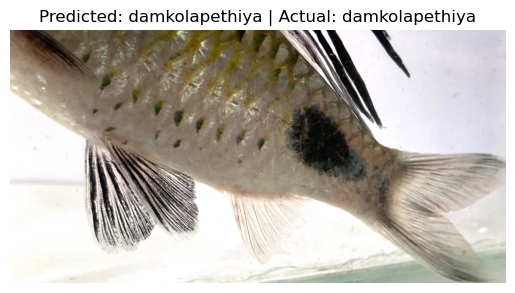

Image: damkolapethiya\2023_06_19_11_56_IMG_1863.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


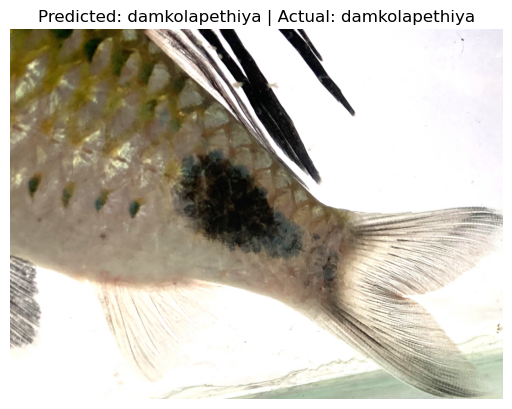

Image: damkolapethiya\2023_06_19_11_56_IMG_1866.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


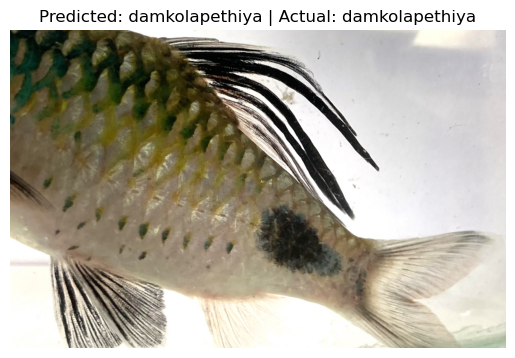

Image: damkolapethiya\2023_06_19_11_56_IMG_1869.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


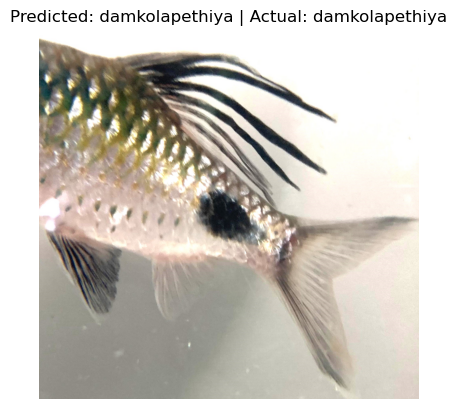

Image: damkolapethiya\2023_06_19_11_57_IMG_1879.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


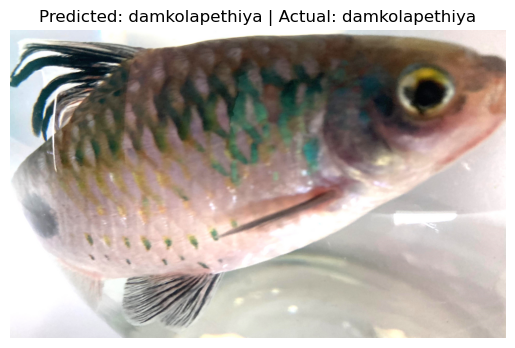

Image: damkolapethiya\2023_06_19_11_58_IMG_1952.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


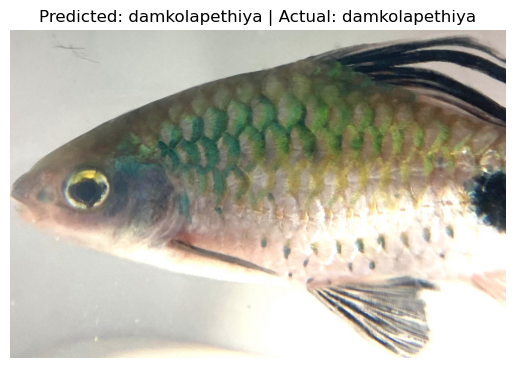

Image: damkolapethiya\2023_06_19_12_00_IMG_2028.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


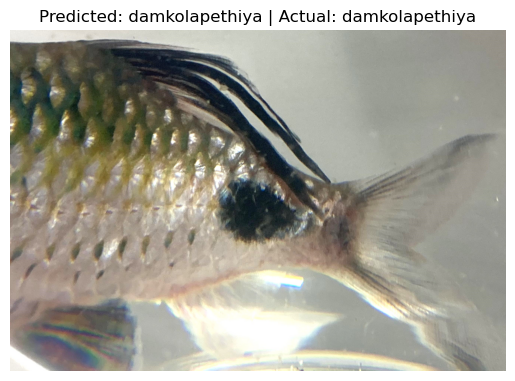

Image: damkolapethiya\2023_06_19_12_00_IMG_2052.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


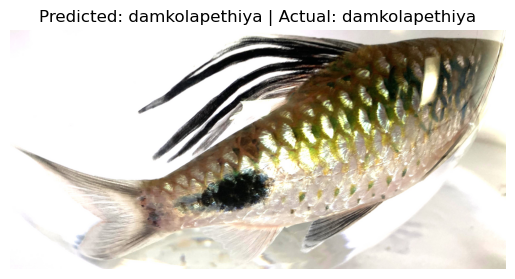

Image: damkolapethiya\2023_06_19_12_01_IMG_2083.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


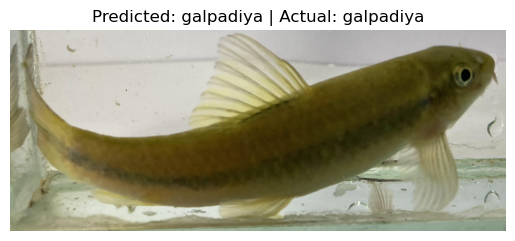

Image: galpadiya\2023_06_19_11_17_IMG_1140.JPG | Predicted: galpadiya | Actual: galpadiya


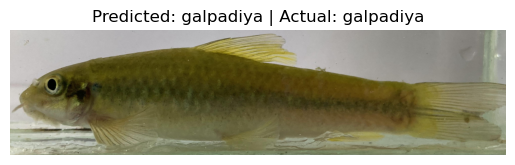

Image: galpadiya\2023_06_19_11_17_IMG_1149.JPG | Predicted: galpadiya | Actual: galpadiya


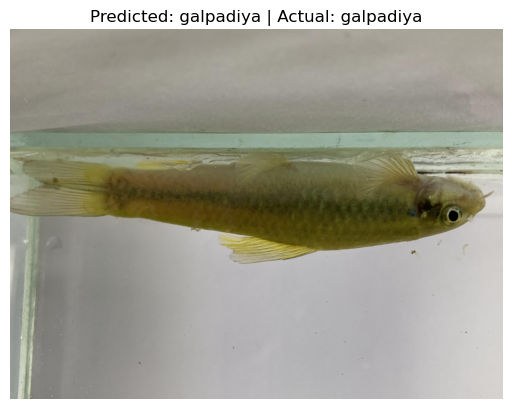

Image: galpadiya\2023_06_19_11_17_IMG_1151.JPG | Predicted: galpadiya | Actual: galpadiya


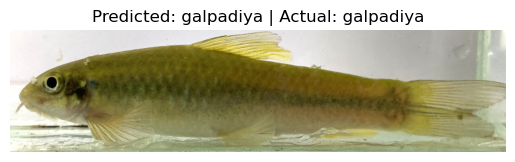

Image: galpadiya\2023_06_19_11_17_IMG_1152.JPG | Predicted: galpadiya | Actual: galpadiya


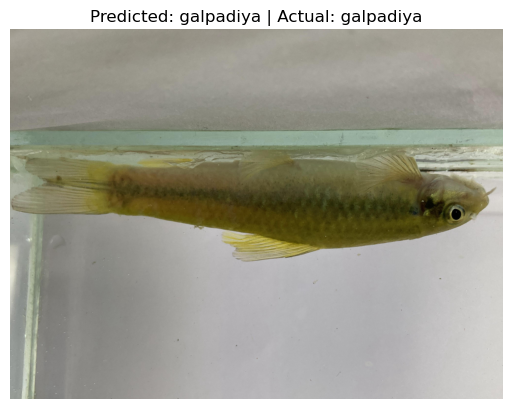

Image: galpadiya\2023_06_19_11_17_IMG_1155.JPG | Predicted: galpadiya | Actual: galpadiya


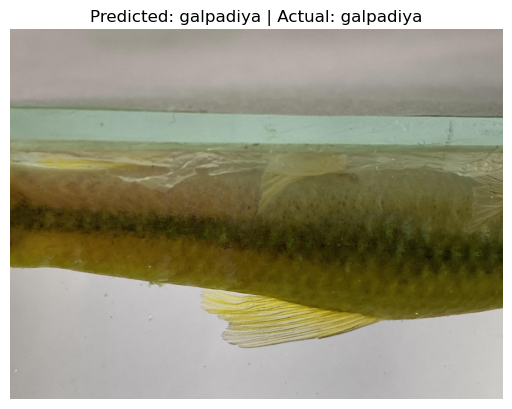

Image: galpadiya\2023_06_19_11_17_IMG_1166.JPG | Predicted: galpadiya | Actual: galpadiya


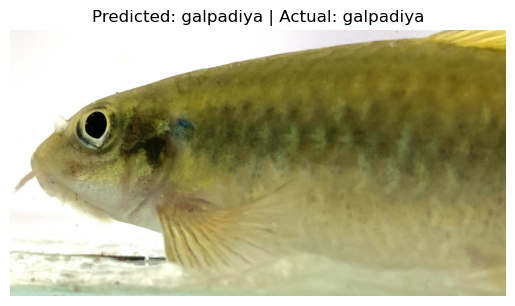

Image: galpadiya\2023_06_19_11_17_IMG_1169.JPG | Predicted: galpadiya | Actual: galpadiya


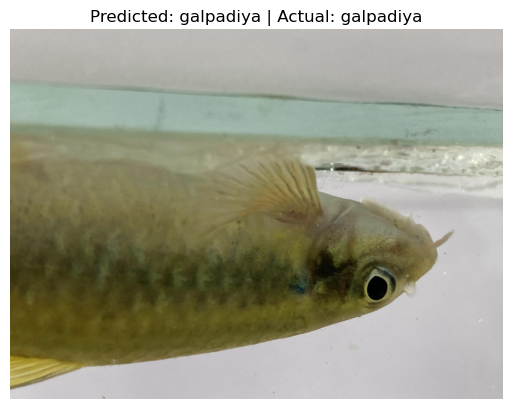

Image: galpadiya\2023_06_19_11_17_IMG_1173.JPG | Predicted: galpadiya | Actual: galpadiya


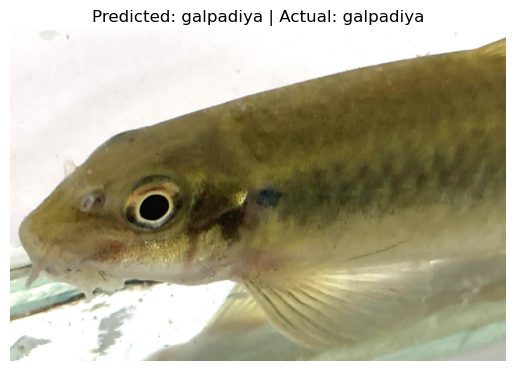

Image: galpadiya\2023_06_19_11_18_IMG_1207.JPG | Predicted: galpadiya | Actual: galpadiya


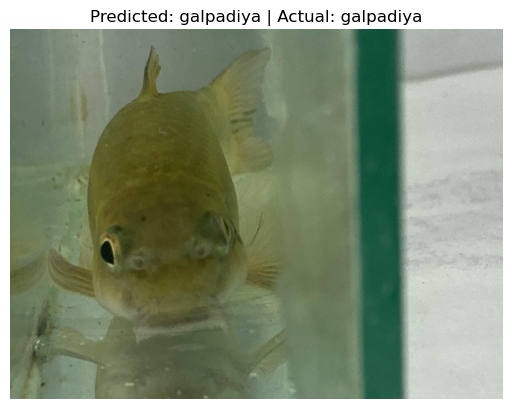

Image: galpadiya\2023_06_19_11_19_IMG_1227.JPG | Predicted: galpadiya | Actual: galpadiya


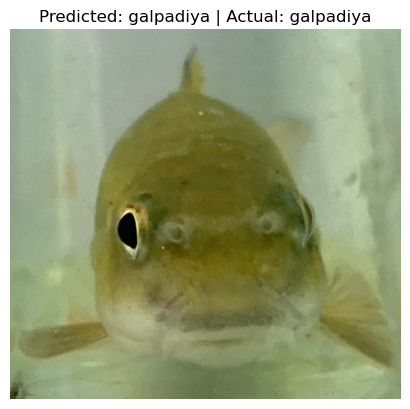

Image: galpadiya\2023_06_19_11_20_IMG_1232.JPG | Predicted: galpadiya | Actual: galpadiya


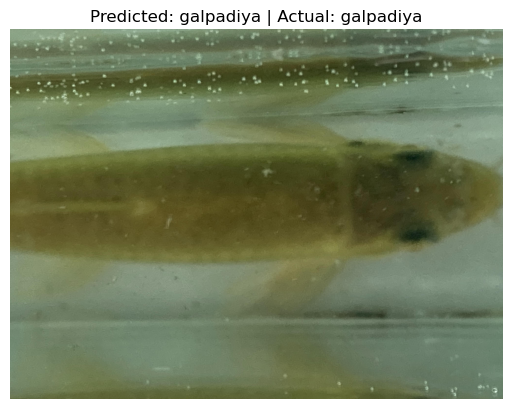

Image: galpadiya\2023_06_19_11_21_IMG_1254.JPG | Predicted: galpadiya | Actual: galpadiya


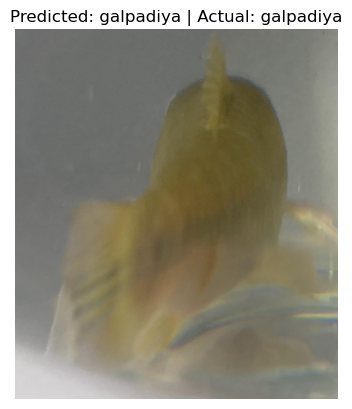

Image: galpadiya\2023_06_19_11_24_IMG_1300.JPG | Predicted: galpadiya | Actual: galpadiya


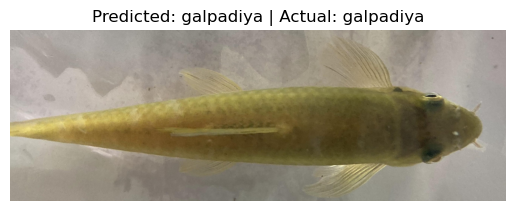

Image: galpadiya\2023_06_19_11_24_IMG_1327.JPG | Predicted: galpadiya | Actual: galpadiya


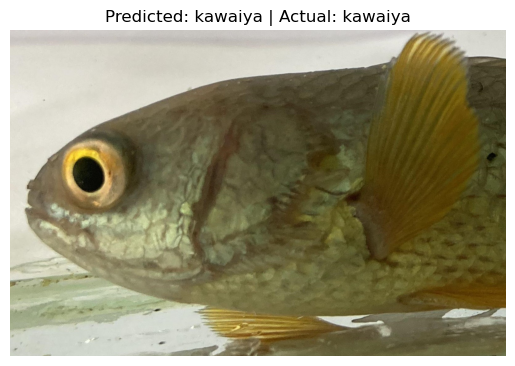

Image: kawaiya\2023_06_19_11_32_IMG_1375.JPG | Predicted: kawaiya | Actual: kawaiya


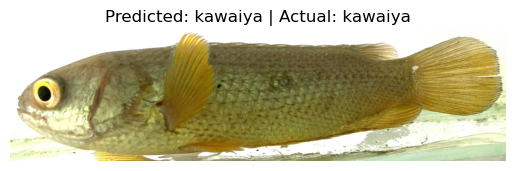

Image: kawaiya\2023_06_19_11_32_IMG_1376.JPG | Predicted: kawaiya | Actual: kawaiya


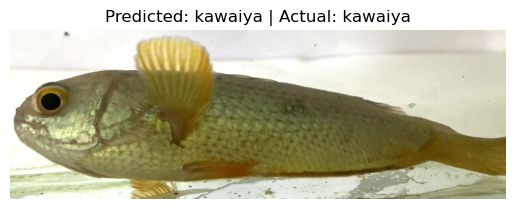

Image: kawaiya\2023_06_19_11_32_IMG_1377.JPG | Predicted: kawaiya | Actual: kawaiya


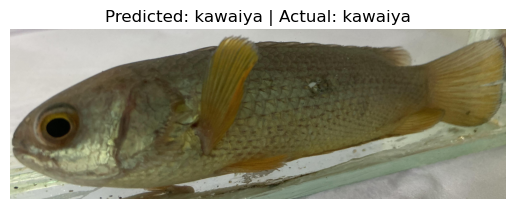

Image: kawaiya\2023_06_19_11_32_IMG_1381.JPG | Predicted: kawaiya | Actual: kawaiya


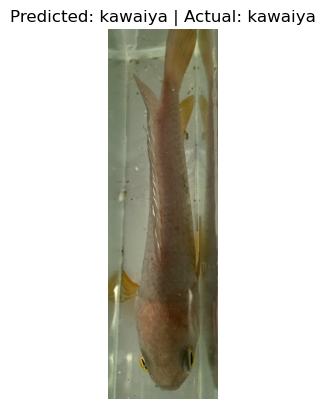

Image: kawaiya\2023_06_19_11_34_IMG_1421.JPG | Predicted: kawaiya | Actual: kawaiya


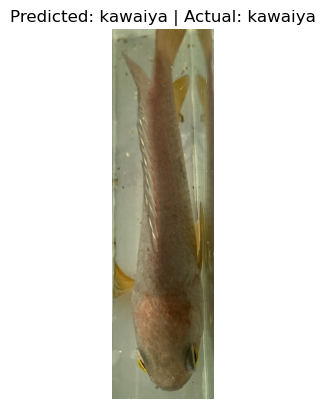

Image: kawaiya\2023_06_19_11_34_IMG_1431.JPG | Predicted: kawaiya | Actual: kawaiya


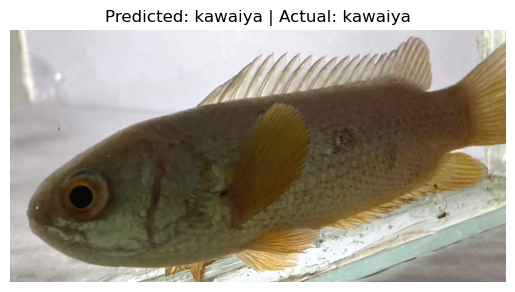

Image: kawaiya\2023_06_19_11_34_IMG_1432.JPG | Predicted: kawaiya | Actual: kawaiya


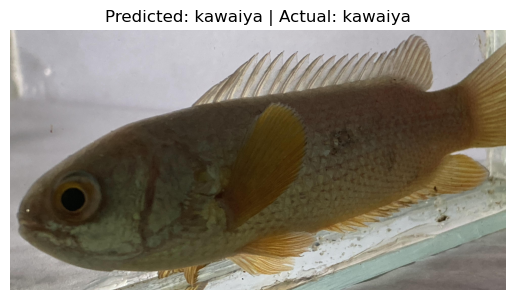

Image: kawaiya\2023_06_19_11_34_IMG_1433.JPG | Predicted: kawaiya | Actual: kawaiya


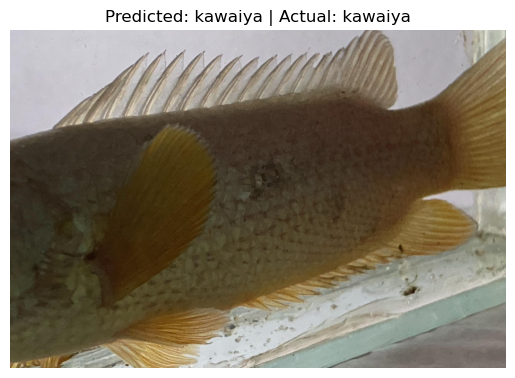

Image: kawaiya\2023_06_19_11_34_IMG_1434.JPG | Predicted: kawaiya | Actual: kawaiya


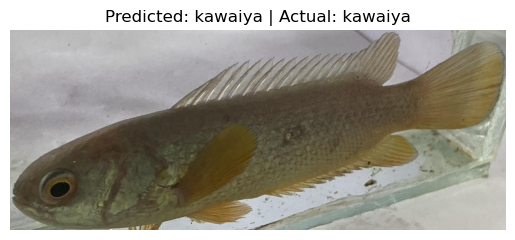

Image: kawaiya\2023_06_19_11_34_IMG_1447.JPG | Predicted: kawaiya | Actual: kawaiya


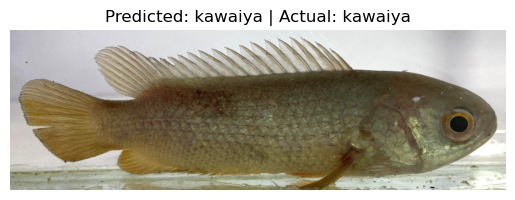

Image: kawaiya\2023_06_19_11_36_IMG_1496.JPG | Predicted: kawaiya | Actual: kawaiya


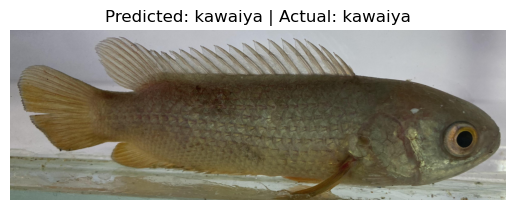

Image: kawaiya\2023_06_19_11_36_IMG_1505.JPG | Predicted: kawaiya | Actual: kawaiya


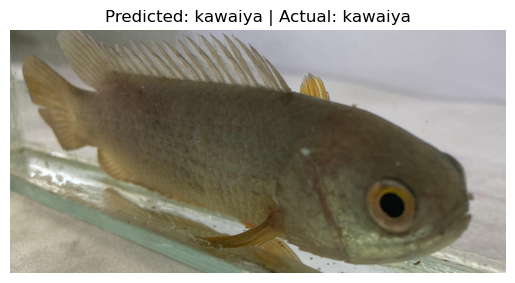

Image: kawaiya\2023_06_19_11_36_IMG_1507.JPG | Predicted: kawaiya | Actual: kawaiya


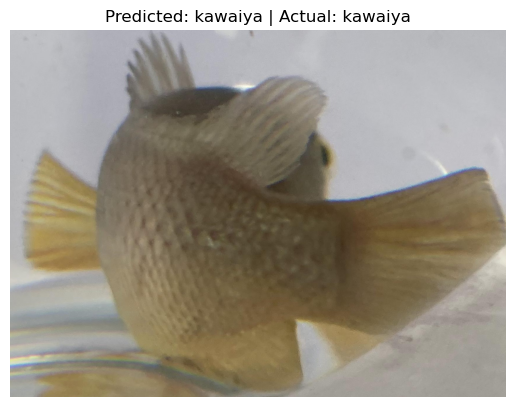

Image: kawaiya\2023_06_19_11_38_IMG_1531.JPG | Predicted: kawaiya | Actual: kawaiya


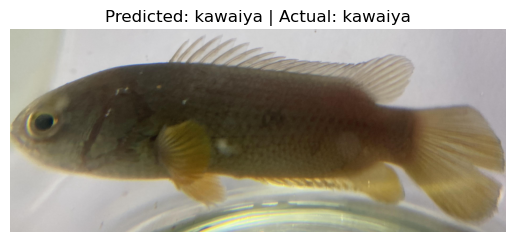

Image: kawaiya\2023_06_19_11_40_IMG_1633.JPG | Predicted: kawaiya | Actual: kawaiya


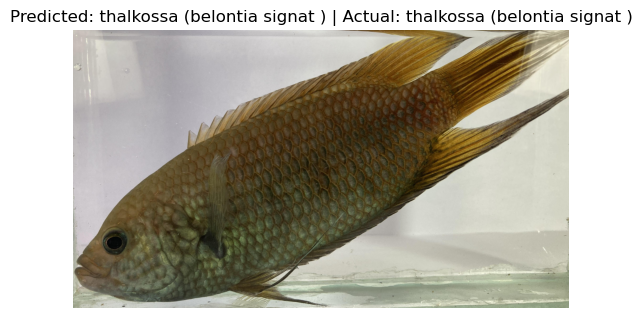

Image: thalkossa (belontia signat )\2023_06_19_10_10_IMG_0225.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


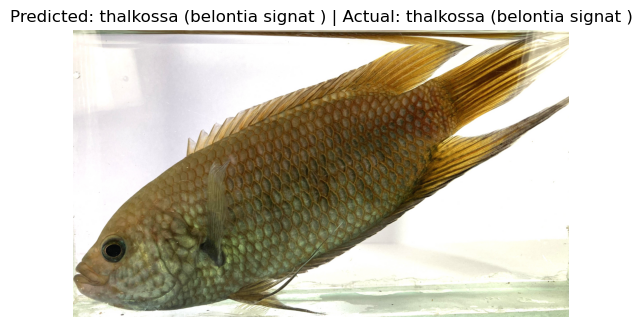

Image: thalkossa (belontia signat )\2023_06_19_10_10_IMG_0226.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


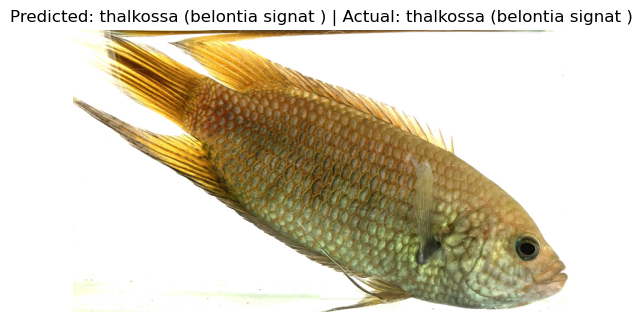

Image: thalkossa (belontia signat )\2023_06_19_10_10_IMG_0227.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


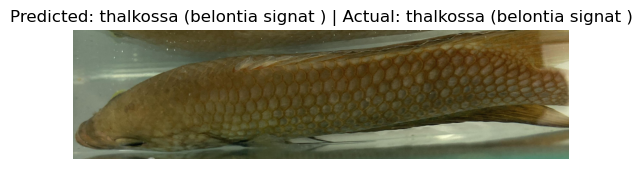

Image: thalkossa (belontia signat )\2023_06_19_10_11_IMG_0244.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


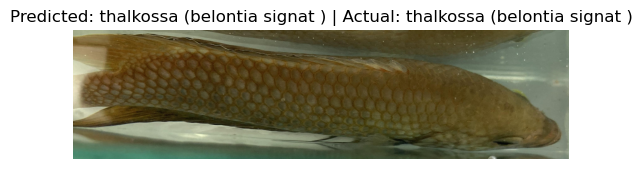

Image: thalkossa (belontia signat )\2023_06_19_10_11_IMG_0245.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


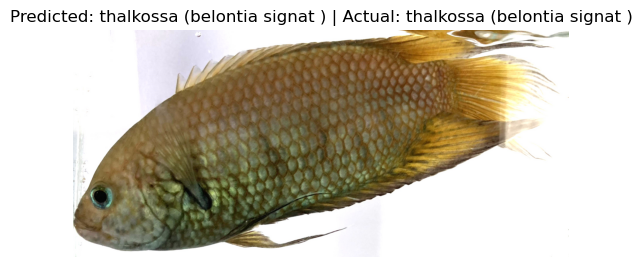

Image: thalkossa (belontia signat )\2023_06_19_10_11_IMG_0251.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


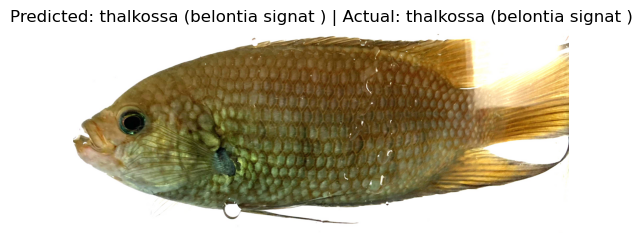

Image: thalkossa (belontia signat )\2023_06_19_10_12_IMG_0253.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


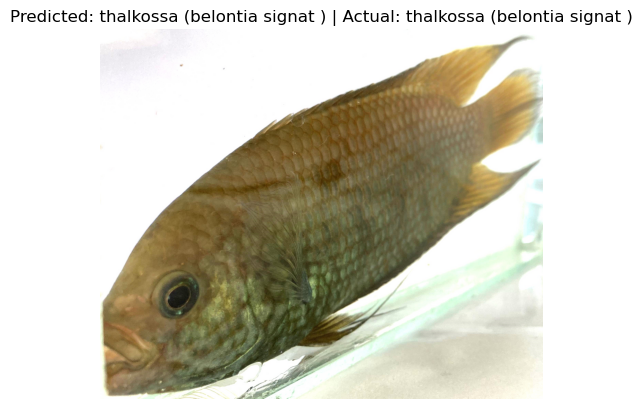

Image: thalkossa (belontia signat )\2023_06_19_10_12_IMG_0260.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


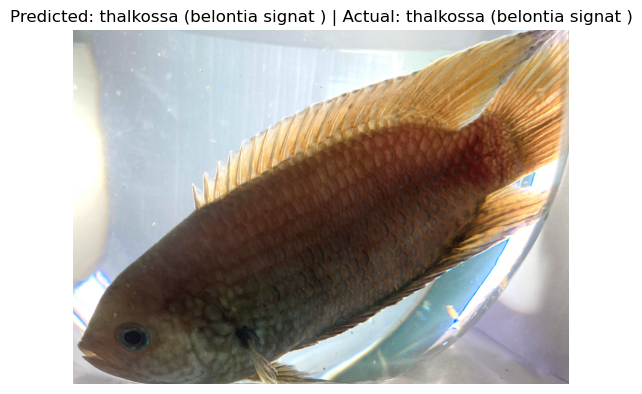

Image: thalkossa (belontia signat )\2023_06_19_10_19_IMG_0303.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


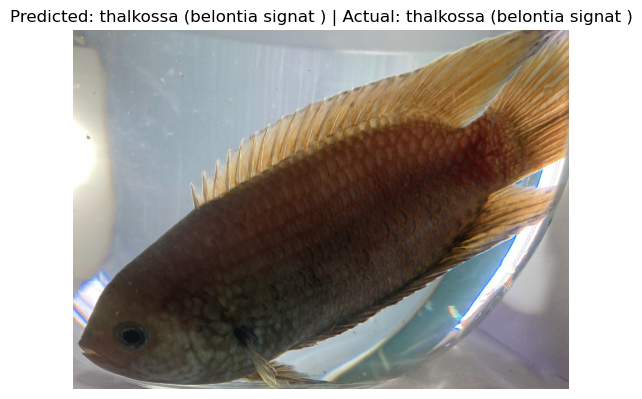

Image: thalkossa (belontia signat )\2023_06_19_10_19_IMG_0305.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


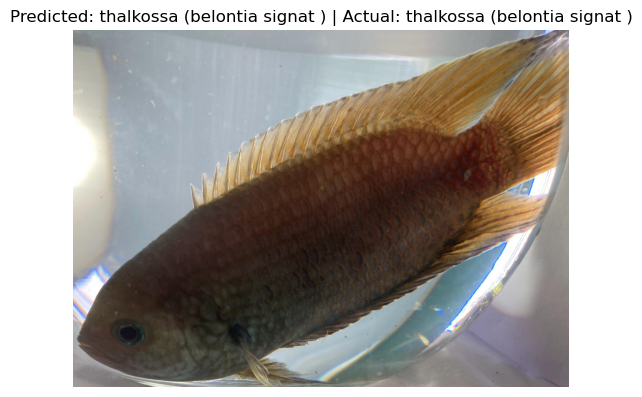

Image: thalkossa (belontia signat )\2023_06_19_10_19_IMG_0307.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


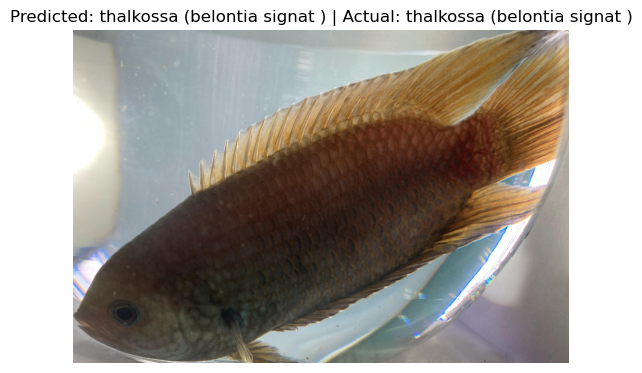

Image: thalkossa (belontia signat )\2023_06_19_10_20_IMG_0310.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


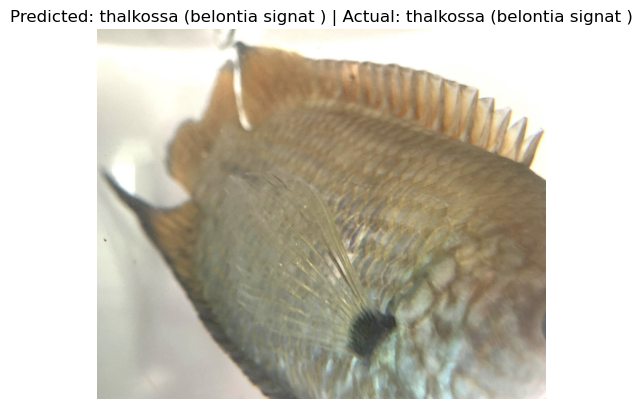

Image: thalkossa (belontia signat )\2023_06_19_10_20_IMG_0322.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


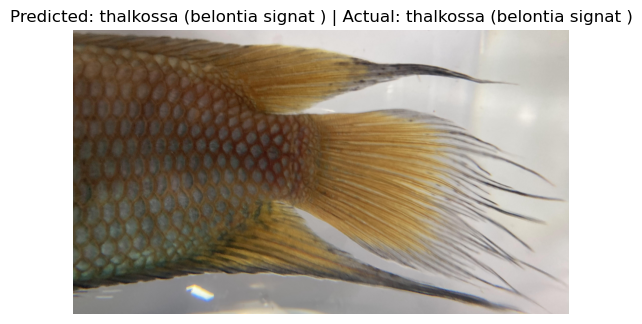

Image: thalkossa (belontia signat )\2023_06_19_10_23_IMG_0383.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


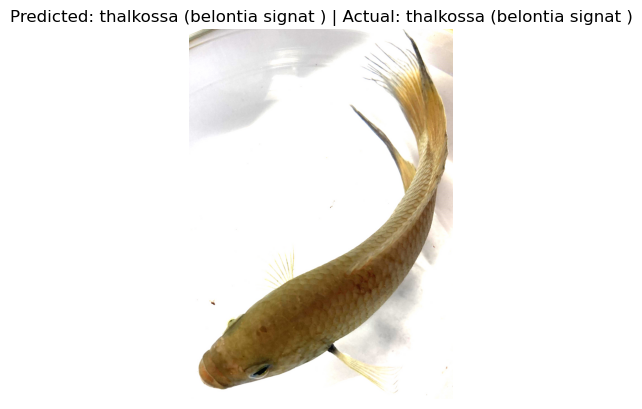

Image: thalkossa (belontia signat )\2023_06_19_10_27_IMG_0441.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


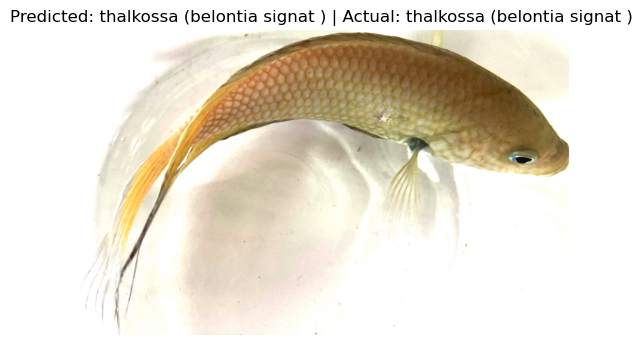

Image: thalkossa (belontia signat )\2023_06_19_10_30_IMG_0507.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


In [27]:
from PIL import Image
import matplotlib.pyplot as plt

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Iterate through the test batch and display image, predicted label, and actual label
for i in range(len(test_batches.filenames)):
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    # Load and display the image using PIL
    image_path = "C:/Users/Sameera maduSanka/Downloads/sam MobileNet/dataSet/test/" + image_filename  # Replace with the actual path to your test dataset
    image = Image.open(image_path)
    plt.imshow(image)
    plt.title(f"Predicted: {predicted_class_name} | Actual: {actual_class_name}")
    plt.axis('off')
    plt.show()
    
    print(f"Image: {image_filename} | Predicted: {predicted_class_name} | Actual: {actual_class_name}")

9/9 [==============================] - 6s 618ms/step


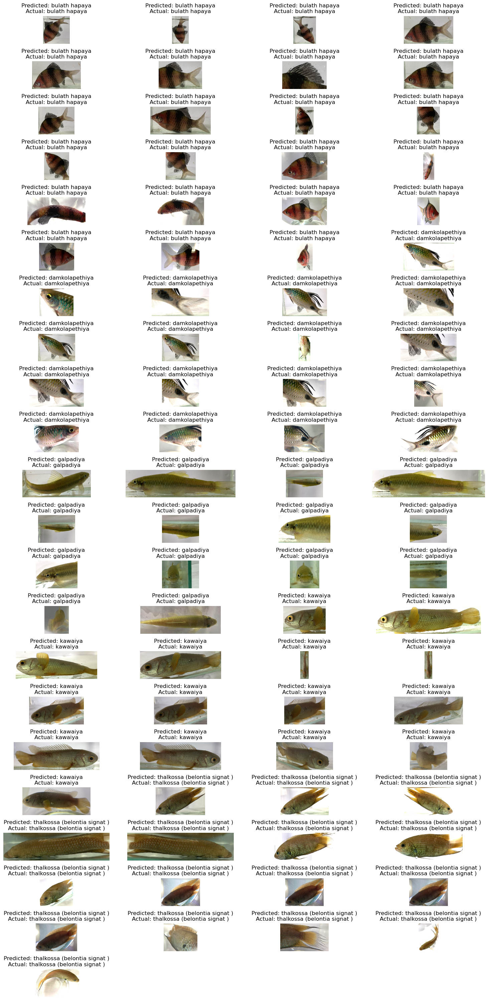

In [28]:
from PIL import Image
import matplotlib.pyplot as plt

from PIL import Image
import matplotlib.pyplot as plt

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Specify the number of columns for the grid
num_columns = 4

# Calculate the number of rows needed based on the number of images and columns
num_images = len(test_batches.filenames)
num_rows = -(-num_images // num_columns)  # Ceiling division

# Create a subplot grid for displaying images
fig, axes = plt.subplots(num_rows, num_columns, figsize=(15, 30))

# Iterate through the test batch and display images in a grid layout
for i in range(num_images):
    row = i // num_columns
    col = i % num_columns
    
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    # Load and display the image using PIL
    image_path = "C:/Users/Sameera maduSanka/Downloads/sam MobileNet/dataSet/test/" + image_filename  # Replace with the actual path to your test dataset
    image = Image.open(image_path)
    
    axes[row, col].imshow(image)
    axes[row, col].set_title(f"Predicted: {predicted_class_name}\nActual: {actual_class_name}")
    axes[row, col].axis('off')

# Hide any remaining empty subplots
for i in range(num_images, num_rows * num_columns):
    row = i // num_columns
    col = i % num_columns
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()